In [36]:
import numpy as np
from scipy.interpolate import interp1d
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML        
%matplotlib inline

In [ ]:
#constants
Lx=3200000 #Lx
Ly=2000000
H=4000 #depth
Hb=300 #ridge height
Wb=300000 #ridge width
Xb=0 #ridge longitude
f=-1e-4 #coriolois parameter
g=9.81 #gravity
rho0=1000 #density
rb=2e-4 #drag velocity
beta=1.5e-11 #coriolis parameter gradient
tau_0=.1 #average wind stress
nu=1000 #Eddy viscosity
tau_d=24*3600 #[s] seconds in a day

In [ ]:
#set up of problem in spectral space
N=200 # number of fourier modes
dx=Lx/N
dy=Ly/N
y = np.arange(-Ly/2,Ly/2,dy)
x = np.arange(-Lx/2,Lx/2,dx)
k = np.reshape(2*np.pi*np.fft.fftfreq(N,d=dx),(1,N))
ksq_recip = np.zeros((1,N))
ksq_recip[0,1:N-1]=1/k[0,1:N-1]**2

In [ ]:
#setting up time stepping
years=3
t1year=31536000
tmax=t1year * years #seconds in a year
dt=500 #time in each step
dt_save=t1year/100
Nt=np.ceil(tmax/dt).astype('int') #number of time steps +1
Nt_save=np.floor(tmax/dt_save).astype('int')

In [104]:
def windForcingBarotropicFluid(tau_1,tau_p):
    #initalizing arrays
    etab=np.zeros((1,N)) #has to do with ridge
    U=0
    Uback=0 #for AB3 time step
    Uback2=0
    psiback=np.zeros((1,N))
    dt_psihat=np.zeros((1,N))
    dt_psiback=np.zeros((1,N))
    psiback2=np.zeros((1,N))
    dt_back2=np.zeros((1,N))
    psi=np.zeros((1,N))#initalizing perturbation component
    psihat=np.zeros((1,N),dtype=np.complex128) #intialize for FFT of psi
    etab = Hb * np.exp(-((x-Xb)/(.5*Wb))**2) #calculates ridge
    etabhat=(np.fft.fft(etab)) #put etab in spectral space

    #to store saved model state
    psi_save=np.zeros((Nt_save,N))
    U_save=np.zeros((Nt_save,N))
    tt_save=np.zeros(Nt_save)
    tfs_save=np.zeros((Nt_save,Ntau))
    psi_save[0,:]=psi
    U_save[0,:]=U
    n_save=1
    t_save=n_save*dt_save



    #time step
    for n in range(1,Nt, 1):
    
        #Current time
        t=dt*n
        
        #Wind Forcing
        tau = tau_0+tau_1*np.sin(2*np.pi*t/tau_p)

        #Calculate topographic form stress
        TFS=(f/H)*np.sum(np.real(1j*k*psihat*np.conj(etabhat)))/N**2
        TFSback=(f/H)*np.sum(np.real(1j*k*psiback*np.conj(etabhat)))/N**2
        TFSback2=(f/H)*np.sum(np.real(1j*k*psiback2*np.conj(etabhat)))/N**2
    
        #Alternative TFS calculation
        #dpsidx = np.real(np.fft.ifft(1j*k*psihat))
        #TFS = (f/H)*np.mean(dpsidx*etab)

        #Perform time step
        Uback2=Uback-(((tau/(H*rho0)-((rb*U)/H)+TFS)*23)-((tau/(H*rho0)-((rb*Uback)/H)+TFSback)*16)+((tau/(H*rho0)-((rb*Uback2)/H)+TFSback2)*5))*(dt/12)
        Uback=U
        U=U+(((tau/(H*rho0)-((rb*U)/H)+TFS)*23)-((tau/(H*rho0)-((rb*Uback)/H)+TFSback)*16)+((tau/(H*rho0)-((rb*Uback2)/H)+TFSback2)*5))*(dt/12)
        dt_psiback = (-Uback*k**3*1j*psiback) + (Uback*f*k*1j*etabhat)/H + beta*1j*k*psiback - rb*k**2*psiback/H - nu*k**4*psiback
        dt_psiback=dt_psiback*ksq_recip
        psiback2=psiback-((dt_psihat*23)-(dt_psiback*16)+(dt_back2*5))*(dt/12)
        dt_back2 = (-Uback2*k**3*1j*psiback2) + (Uback2*f*k*1j*etabhat)/H + beta*1j*k*psiback2 - rb*k**2*psiback2/H - nu*k**4*psiback2
        dt_back2=dt_back2*ksq_recip
        dt_psihat = (-U*k**3*1j*psihat) + (U*f*k*1j*etabhat)/H + beta*1j*k*psihat - rb*k**2*psihat/H - nu*k**4*psihat
        dt_psihat=dt_psihat*ksq_recip
        psiback=psihat
        psihat=psihat+((dt_psihat*23)-(dt_psiback*16)+(dt_back2*5))*(dt/12)

        #Store model state
        if t>=t_save:
            psi=np.real((np.fft.ifft(psihat)))
            psi_save[n_save,:] = psi
            U_save[n_save,:] = U
            tt_save[n_save] = t_save
            tfs_save[n_save] = TFS
            n_save=n_save+1
            t_save=n_save*dt_save
    return psi_save,U_save,tt_save,tfs_save

In [ ]:
#tau_1=.1 
#tau_p=3*24*3600 #[s] wind period
#psi,U,t,tfs=windForcingBarotropicFluid(.1,3*24*3600)

In [ ]:
# varying wind frequency with constant amplitude 
tau_max=30*tau_d
dtau=tau_d/2 #time in each step
Ntau=np.ceil(tau_max/dtau).astype('int')
psi=np.zeros([Ntau,Nt_save,N])
U=np.zeros([Ntau,Nt_save,N])
t=np.zeros([Ntau,Nt_save])
tfs=np.zeros([Ntau,Nt_save])
for i in range(1,Ntau,1):
    r=i*dtau
    psi[i],U[i],t[i],tfs[i]=windForcingBarotropicFluid(.1,r)

In [ ]:
#varying frequencies with varying amplitude 

<IPython.core.display.Javascript object>


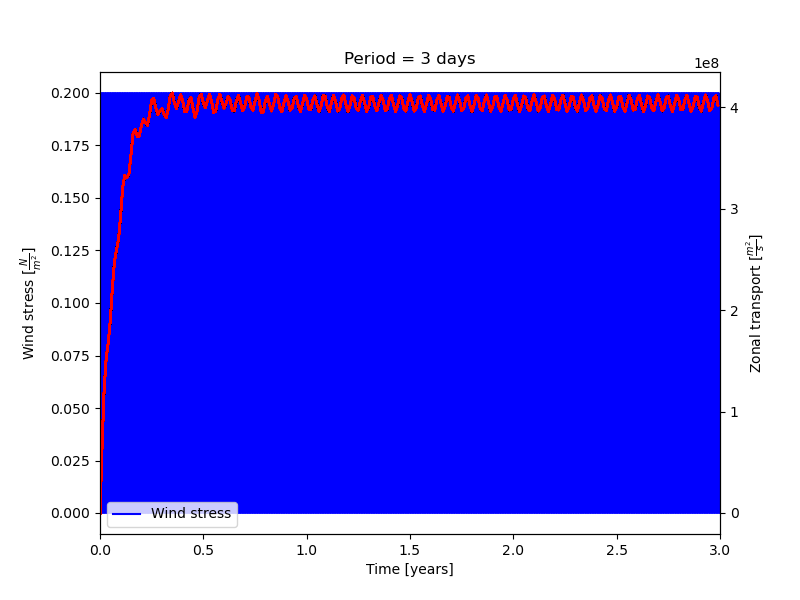

Text(0, 0.5, 'Zonal transport $[\\frac{m^2}{s}]$')

In [17]:
fig, ax = plt.subplots(figsize = (8, 6))
tau_1=.1 
tau_p=3*24*3600 #[s] wind period
ax2=ax.twinx()
r = np.arange(0,Nt)*dt
tau = tau_0+tau_1*np.sin(2*np.pi*r/(tau_p))
ax.plot(r/(t1year),tau,color="b",label='Wind stress') 
ax2.plot(t/(t1year),U*Ly*H,color='r',label='Zonal transport')
ax.set_xlabel('Time [years]')
ax.set_ylabel('Wind stress 'r'$[\frac{N}{m^2}]$')
plt.title('Period = 3 days')
ax.legend(loc='lower left')
#ax2.legend(loc='lower right')
ax.set_xlim(0,3)
ax2.set_ylabel('Zonal transport 'r'$[\frac{m^2}{s}]$')

In [90]:
GMT=tfs_save*H*Lx/f
GMTT=np.fft.fft(GMT)
angle=np.angle(GMTT)
phase=np.fft.ifft(angle)
plt.plot(np.abs(GMTT))
plt.plot(-1*angle)
#plt.ylim(-1e7,1e7)
plt.xlim(0,20)
print(GMTT[14])
phase[13]
print(np.abs(GMTT[0:20]))
print(angle[6])

(-734810.3025120378+9532119.215655942j)
[8.51384320e+08 1.67432785e+07 1.62931637e+07 1.57211759e+07
 1.62051391e+07 2.57051991e+07 4.06512638e+08 4.99370476e+07
 3.00656451e+07 2.33366576e+07 2.01108308e+07 1.90977931e+07
 4.01901629e+07 9.25296804e+06 9.56039973e+06 9.41993235e+06
 9.16394247e+06 9.16209501e+06 1.34602178e+07 4.44920970e+06]
-1.666502934315613


<IPython.core.display.Javascript object>


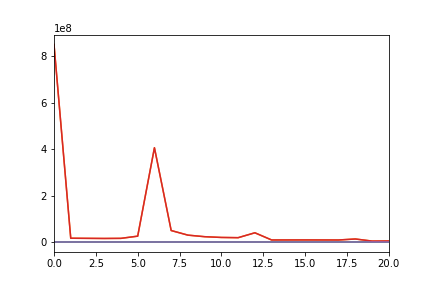

(0.0, 20.0)

In [88]:
plt.plot(-1*angle)
plt.xlim(0,20)

In [42]:
newU=np.zeros((500,200,200))
newP=np.zeros((500,200,200))
for i in range(0,N):
    newU[:,:,i]=-1*U*y[i]
    newP[:,:,i]=psi
tot=newP+newU
tot.shape

array([[[     0.        ,      0.        ,      0.        , ...,
              0.        ,      0.        ,      0.        ],
        [     0.        ,      0.        ,      0.        , ...,
              0.        ,      0.        ,      0.        ],
        [     0.        ,      0.        ,      0.        , ...,
              0.        ,      0.        ,      0.        ],
        ...,
        [     0.        ,      0.        ,      0.        , ...,
              0.        ,      0.        ,      0.        ],
        [     0.        ,      0.        ,      0.        , ...,
              0.        ,      0.        ,      0.        ],
        [     0.        ,      0.        ,      0.        , ...,
              0.        ,      0.        ,      0.        ]],

       [[  -160.45490668,   -160.45490668,   -160.45490668, ...,
           -160.45490668,   -160.45490668,   -160.45490668],
        [  -157.42505464,   -157.42505464,   -157.42505464, ...,
           -157.42505464,   -157.42505

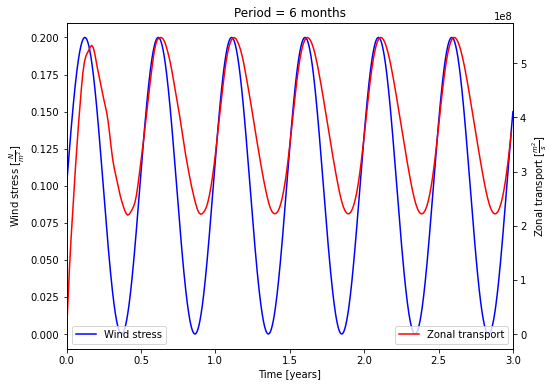

In [16]:
fig, ax = plt.subplots(figsize = (8, 6))
ax2=ax.twinx()
t = np.arange(0,Nt)*dt
tau = tau_0+tau_1*np.sin(2*np.pi*t/(tau_p))
ax.plot(t/(t1year),tau,color="b",label='Wind stress') 
ax2.plot(tt_save/(t1year),U_save*Ly*H,color='r',label='Zonal transport')
ax.set_xlabel('Time [years]')
ax.set_ylabel('Wind stress 'r'$[\frac{N}{m^2}]$')
plt.title('Period = 6 months')
ax.legend(loc='lower left')
ax2.legend(loc='lower right')
ax.set_xlim(0,3)
ax2.set_ylabel('Zonal transport 'r'$[\frac{m^2}{s}]$')
plt.savefig('Zonal6months.png')

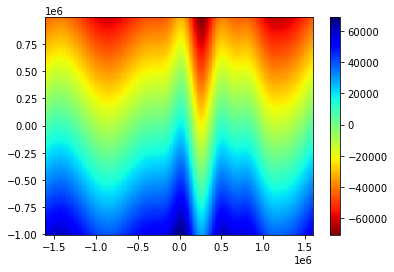

In [44]:
fig=plt.figure()
ax=fig.add_subplot(111)
plt.set_cmap('jet_r')
A=ax.pcolor(x,y,tot[50,:,:].T,shading='auto')
plt.colorbar(A)

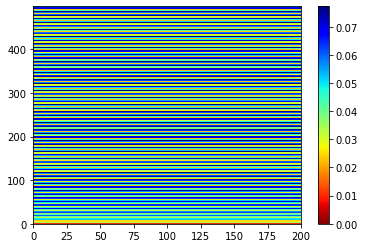

In [39]:
fig=plt.figure()
ax=fig.add_subplot(111)
plt.set_cmap('jet_r')
A=ax.pcolor(U[0:Nt_save-1,:])
plt.colorbar(A)

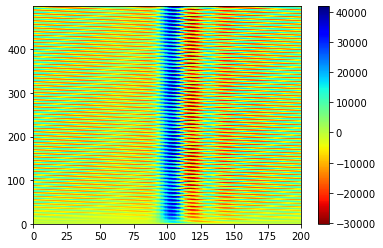

In [38]:
fig=plt.figure()
ax=fig.add_subplot(111)
plt.set_cmap('jet_r')
A=ax.pcolor(psi[0:Nt_save-1,:])
plt.colorbar(A)

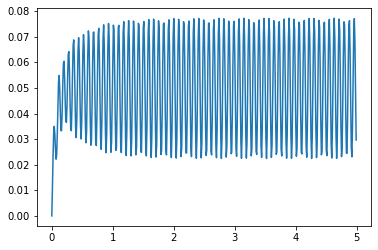

In [37]:
tau_1=.1 #wind stress
tau_p=30*24*3600 #[s] wind period
r = np.arange(0,Nt)*dt
#tau = tau_0+tau_1*np.sin(2*np.pi*r/tau_p)
plt.plot(t/t1year,U[:,1]) 


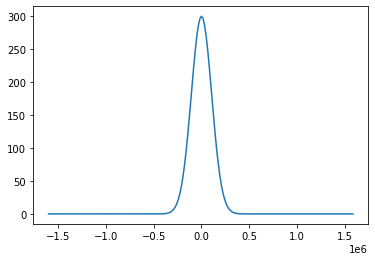

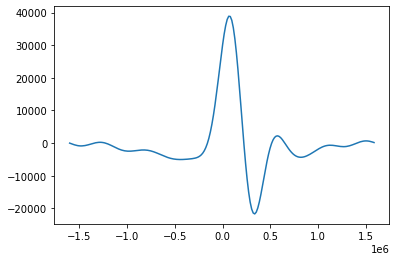

In [86]:
fig=plt.figure()
ax=fig.add_subplot(111)
plt.set_cmap('jet_r')
ax.plot(x,etab)
fig=plt.figure()
ax=fig.add_subplot(111)
ax.plot(x,psi_save[Nt_save-1,:])
    

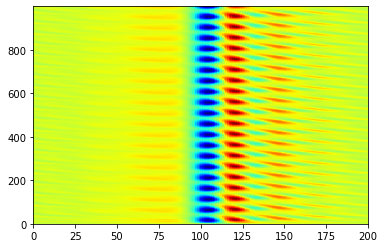

In [87]:
#X,Y = np.mgrid[tt_save,x]
fig=plt.figure()
ax=fig.add_subplot(111)
plt.set_cmap('jet_r')
ax.pcolor(psi_save[0:Nt_save-1,:])

In [88]:
#Print terms in momentum balance at the end of the calculation, in units of N/m^2
print(TFS*rho0*H) #Topographic form stress
print(tau) #Wind stress
print(-rb*U*rho0) #Frictional drag
print(U) #Mean flow speed

-0.1835798846630708
[0.1        0.1000202  0.1000404  ... 0.19849128 0.19848778 0.19848428]
-0.013696958334728239
0.06848479167364119


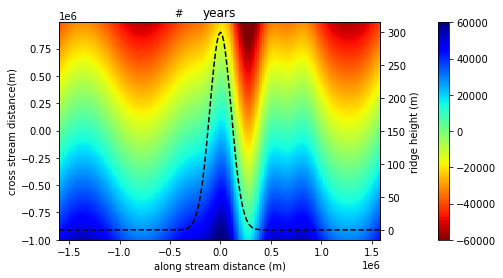

In [54]:
fig, ax = plt.subplots(figsize=(8,4))


#ax.set_ylim((-.3, .3))
ax2=ax.twinx()
ax2.plot(x,etab,'--',color='k')
ax.set_ylabel('cross stream distance(m)')
ax2.set_ylabel('ridge height (m)')
ax.set_xlabel('along stream distance (m)')
ax.set_title('years')
ttl = ax.text(.36, 1.03, '#', transform = ax.transAxes)
quad = ax.pcolor(x,y,tot[66,:-1,:-1].T,vmin=-60000,vmax=60000,cmap='jet_r')
fig.colorbar(quad,pad=.13)
#plt.savefig('6MonthWindPeriod_streamfunction.png')

In [55]:
def animate(i):
    quad.set_array((tot[i,:-1,:-1].T).ravel())
    ttl.set_text((t[i]/t1year))
    return (quad)

In [56]:
anim = animation.FuncAnimation(fig, animate,
                               frames=Nt_save, interval=60, 
                               repeat=True)

In [57]:
HTML(anim.to_jshtml())

Animation size has reached 21029206 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [126]:
writervideo = animation.PillowWriter(fps=30)
anim.save('6monthWithRidge.gif', writer=writervideo,dpi=150)